<a href="https://colab.research.google.com/github/YasserAlbogami/NBA_EDA/blob/main/NBA_Eda.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 🏀 NBA 2018–2019 Season General Analysis

This analysis is part of a broader study on **NBA player and team performance across multiple seasons**.  
Focusing on the 2018–2019 season, it highlights key trends and individual achievements by examining player statistics such as points, assists, rebounds, and shooting efficiency. 📊

## 🎯 Key Objectives
- 🔥 Identify breakout performances from emerging stars  
- 🔄 Evaluate the impact of mid-season trades on team dynamics  
- 📉 Highlight underperforming players or those affected by injuries  
- 🏆 Assess the contributions of top players to playoff-contending teams  


🛠️ We will go through the data with a full **exploratory data analysis (EDA)** to uncover season-specific insights and understand the competitive landscape of the 2018–2019 NBA season.


In [ ]:
!pip install ydata-profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 2.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 400.1/400.1 kB 9.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 15.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.0/679.0 kB 24.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.7/37.7 MB 33.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.3/43.3 kB 3.1 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=63c32cb026c5f4bce2078b5efb0ae318fb5b01d5778808257bdb1a13cd5b732e
  Stored in directory: /root/.cache/pip/wheels/8d/55/1a/19cd535375ed1ede0c996405ebffe34b196d78e2d9545723a2
Successfully built htmlmin
  Attempting uninstall: scipy
    Found existing installation: scipy 1.16.0
    Uninstalling scipy-1.16.0:
      

In [ ]:
# @title
#Import all relevant libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.subplots as sp
import plotly.graph_objects as go

from scipy.stats import zscore


## This statement allows the visuals to render within your Jupyter Notebook.
%matplotlib inline

 Loading the data
We can now load the dataset into pandas using the read_csv() function. This converts the CSV file into a Pandas dataframe.

In [ ]:
#Read in the csv file and convert to a Pandas dataframe
df = pd.read_csv("https://huggingface.co/datasets/Hatman/NBA-Players-Results-2018/resolve/main/player_stats_2018.csv")

In [ ]:
#Read in the csv file and convert to a Pandas dataframe
df

,Rk,Name,Age,G,GS,MP,FG,FGA,FG%,3P,...,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS/G,TEAM
0,1,Kyrie Irving,26,67,67,33.0,9.0,18.5,0.487,2.6,...,1.1,3.9,5.0,6.9,1.5,0.5,2.6,2.5,23.8,Boston Celtics
1,2,Jayson Tatum,20,79,79,31.1,5.9,13.1,0.450,1.5,...,0.9,5.2,6.0,2.1,1.1,0.7,1.5,2.1,15.7,Boston Celtics
2,3,Al Horford,32,68,68,29.0,5.7,10.6,0.535,1.1,...,1.8,5.0,6.7,4.2,0.9,1.3,1.5,1.9,13.6,Boston Celtics
3,4,Marcus Morris,29,75,53,27.9,5.0,11.3,0.447,1.9,...,1.0,5.1,6.1,1.5,0.6,0.3,1.2,2.4,13.9,Boston Celtics
4,5,Marcus Smart,24,80,60,27.5,3.0,7.1,0.422,1.6,...,0.7,2.2,2.9,4.0,1.8,0.4,1.5,2.5,8.9,Boston Celtics
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,1,Jrue Holiday,28,67,67,35.9,8.2,17.3,0.472,1.8,...,1.1,3.9,5.0,7.7,1.6,0.8,3.1,2.2,21.2,New Orleans Pelicans
146,2,Anthony Davis,25,56,56,33.0,9.5,18.3,0.517,0.9,...,3.1,8.9,12.0,3.9,1.6,2.4,2.0,2.4,25.9,New Orleans Pelicans
147,3,Julius Randle,24,73,49,30.6,7.8,14.9,0.524,0.9,...,2.2,6.5,8.7,3.1,0.7,0.6,2.8,3.4,21.4,New Orleans Pelicans
148,4,Elfrid Payton,24,42,42,29.8,4.3,9.8,0.434,0.8,...,1.2,4.1,5.2,7.6,1.0,0.4,2.7,1.9,10.6,New Orleans Pelicans


### Viewing the dataframe
We can get a quick sense of the size of our dataset by using the shape method. This returns a tuple with the number of rows and columns in the dataset.

In [ ]:
df.shape #show the shape of the data

(150, 29)

**Note:**
- Your gun/clock time is the time on the official race clock from the moment the race started (when the gun went off) to when you crossed over the finish line.
- Your net/chip time is the time from when you personally cross the starting line to when you cross the finish.

### Viewing the dataframe
We can get a quick sense of the size of our dataset by using the shape method. This returns a tuple with the number of rows and columns in the dataset.

In [ ]:
df.head(10)

,Rk,Name,Age,G,GS,MP,FG,FGA,FG%,3P,...,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS/G,TEAM
0,1,Kyrie Irving,26,67,67,33.0,9.0,18.5,0.487,2.6,...,1.1,3.9,5.0,6.9,1.5,0.5,2.6,2.5,23.8,Boston Celtics
1,2,Jayson Tatum,20,79,79,31.1,5.9,13.1,0.450,1.5,...,0.9,5.2,6.0,2.1,1.1,0.7,1.5,2.1,15.7,Boston Celtics
2,3,Al Horford,32,68,68,29.0,5.7,10.6,0.535,1.1,...,1.8,5.0,6.7,4.2,0.9,1.3,1.5,1.9,13.6,Boston Celtics
3,4,Marcus Morris,29,75,53,27.9,5.0,11.3,0.447,1.9,...,1.0,5.1,6.1,1.5,0.6,0.3,1.2,2.4,13.9,Boston Celtics
4,5,Marcus Smart,24,80,60,27.5,3.0,7.1,0.422,1.6,...,0.7,2.2,2.9,4.0,1.8,0.4,1.5,2.5,8.9,Boston Celtics
5,1,Kawhi Leonard,27,60,60,34.0,9.3,18.8,0.496,1.9,...,1.3,6.0,7.3,3.3,1.8,0.4,2.0,1.5,26.6,Toronto Raptors
6,2,Kyle Lowry,32,65,65,34.0,4.7,11.4,0.411,2.4,...,0.6,4.2,4.8,8.7,1.4,0.5,2.8,2.6,14.2,Toronto Raptors
7,3,Pascal Siakam,24,80,79,31.9,6.5,11.8,0.549,1.0,...,1.6,5.3,6.9,3.1,0.9,0.7,1.9,3.0,16.9,Toronto Raptors
8,4,Danny Green,31,80,80,27.7,3.7,7.9,0.465,2.5,...,0.8,3.2,4.0,1.6,0.9,0.7,0.9,2.1,10.3,Toronto Raptors
9,5,Fred VanVleet,24,64,28,27.5,3.8,9.4,0.410,1.8,...,0.3,2.3,2.6,4.8,0.9,0.3,1.3,1.7,11.0,Toronto Raptors


In [ ]:
# Enrichment

## 1. Data Profiling:"
Data profiling is a comprehensive process of examining the data available in an existing dataset and collecting statistics and information about that data.

In [ ]:
categorical_cols = df.select_dtypes(include=['object']).columns
for col in categorical_cols:
   print(f"Column: {col}")
   print(df[col].value_counts())
   print("-" * 20)

numerical_cols = df.select_dtypes(include=np.number).columns
for col in numerical_cols:
  print(f"Column: {col}")
  print(df[col].describe())
  print("-" * 20)

Column: Name
Name
Jimmy Butler        3
Kyle Lowry          2
Wesley Matthews     2
Caris LeVert        2
Robert Covington    2
                   ..
Jrue Holiday        1
Anthony Davis       1
Julius Randle       1
Elfrid Payton       1
Nikola Mirotić      1
Name: count, Length: 136, dtype: int64
--------------------
Column: TEAM
TEAM
Boston Celtics            5
Toronto Raptors           5
New York Knicks           5
Brooklyn Nets             5
Philadelphia 76ers        5
Cleveland Cavaliers       5
Indiana Pacers            5
Detroit Pistons           5
Chicago Bulls             5
Milwaukee Bucks           5
Miami Heat                5
Atlanta Hawks             5
Charlotte Hornets         5
Washington Wizards        5
Orlando Magic             5
Oklahoma City Thunder     5
Portland Trail Blazers    5
Utah Jazz                 5
Denver Nuggets            5
Minnesota Timberwolves    5
Golden State Warriors     5
Los Angeles Clippers      5
Sacramento Kings          5
Phoenix Suns      

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145 entries, 0 to 144
Data columns (total 29 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Rk      145 non-null    int64  
 1   Name    145 non-null    object 
 2   Age     145 non-null    int64  
 3   G       145 non-null    int64  
 4   GS      145 non-null    int64  
 5   MP      145 non-null    float64
 6   FG      145 non-null    float64
 7   FGA     145 non-null    float64
 8   FG%     145 non-null    float64
 9   3P      145 non-null    float64
 10  3PA     145 non-null    float64
 11  3P%     145 non-null    float64
 12  2P      145 non-null    float64
 13  2PA     145 non-null    float64
 14  2P%     145 non-null    float64
 15  eFG%    145 non-null    float64
 16  FT      145 non-null    float64
 17  FTA     145 non-null    float64
 18  FT%     145 non-null    float64
 19  ORB     145 non-null    float64
 20  DRB     145 non-null    float64
 21  TRB     145 non-null    float64
 22  AS

## 🏀 Features Description 🏀

| Feature   | Description                          | Detailed Description (For Non-Basketballers) |
|-----------|--------------------------------------|----------------------------------------------|
| **Rk**    | Rank of the player on the team       | Player's position in the team's internal list (can be used for order or stats sorting) |
| **Name**  | Full name of the player              | The player's full name (e.g., LeBron James)  |
| **Age**   | Age of the player                    | How old the player was during the season     |
| **G**     | Games Played                         | Total number of matches the player appeared in |
| **GS**    | Games Started                        | Number of matches the player started from the beginning |
| **MP**    | Minutes Played                       | Total minutes the player spent on the court across all games |
| **FG**    | Field Goals Made                     | Total number of baskets (2- or 3-points) successfully scored |
| **FGA**   | Field Goals Attempted                | Total number of shot attempts, whether successful or not |
| **FG%**   | Field Goal Percentage                | Success rate of overall shots taken (FG ÷ FGA) |
| **3P**    | Three-Point Field Goals Made         | Number of successful 3-point shots made (from long distance) |
| **3PA**   | Three-Point Field Goals Attempted    | Number of 3-point shots the player attempted |
| **3P%**   | Three-Point Field Goal Percentage    | Success rate of 3-point shots (3P ÷ 3PA)     |
| **2P**    | Two-Point Field Goals Made           | Number of successful 2-point shots made (closer shots) |
| **2PA**   | Two-Point Field Goals Attempted      | Number of 2-point shots attempted            |
| **2P%**   | Two-Point Field Goal Percentage      | Success rate of 2-point shots (2P ÷ 2PA)     |
| **eFG%**  | Effective Field Goal Percentage      | Adjusted shooting percentage that gives more weight to 3-point shots |
| **FT**    | Free Throws Made                     | Number of successful free throws (uncontested shots after fouls) |
| **FTA**   | Free Throw Attempts                  | Number of free throws attempted              |
| **FT%**   | Free Throw Percentage                | Success rate of free throws (FT ÷ FTA)       |
| **DRB**   | Defensive Rebounds                   | Times the player grabbed the ball after the opponent missed a shot |
| **TRB**   | Total Rebounds                       | Total number of rebounds (defensive + offensive) |
| **AST**   | Assists                              | Number of passes that directly led to a teammate scoring |
| **STL**   | Steals                               | Number of times the player took the ball from the opposing team |
| **BLK**   | Blocks                               | Times the player stopped an opponent’s shot mid-air |
| **TOV**   | Turnovers                            | Mistakes that caused the player to lose the ball to the opponent |
| **PF**    | Personal Fouls                       | Number of fouls committed by the player      |
| **PTS/G** | Points per Game                      | Average points scored per game (total points ÷ games played) |
| **team**  | Team the player was on               | The NBA team the player was representing during the season |


In [ ]:
from ydata_profiling import ProfileReport
profile = ProfileReport(df, title="🏀 NBA 2018–2019 Season Analysis")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 29/29 [00:00<00:00, 51.69it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

The process of profiling differs slightly for categorical and numerical variables due to their inherent differences.

**The two main types of data are:**
- Quantitative (numerical) data
- Qualitative (categorical) data

### Data Quality Checks
Data quality checks involve the process of ensuring that the data is accurate, complete, consistent, relevant, and reliable.


**Here are typical steps involved in checking data quality:**

#### 1. Reliability:
Evaluate the data's source and collection process to determine its trustworthiness.

In [ ]:
# in the kaggle page mentioned data source
# Print the column names to identify unclear fields
print("Column Names:")
print(df.columns.tolist())

print("\n" + "-"*50 + "\n")



unclear_columns = [col for col in df.columns if "Unnamed" in col or "?" in col or "\\" in col]
print("\n unclear column names:")
print(unclear_columns if unclear_columns else "None found")

Column Names:
['Rk', 'Name', 'Age', 'G', 'GS', 'MP', 'FG', 'FGA', 'FG%', '3P', '3PA', '3P%', '2P', '2PA', '2P%', 'eFG%', 'FT', 'FTA', 'FT%', 'ORB', 'DRB', 'TRB', 'AST', 'STL', 'BLK', 'TOV', 'PF', 'PTS/G', 'TEAM']

--------------------------------------------------


 unclear column names:
None found


### Data Quality Check — Reliability

The dataset was obtained from Hugging Face and uploaded by a non-official user (`lazylegere`). Although the data source is not an official organization, the dataset appears well-structured and clean.

Upon inspection:
- The dataset includes 176 unique countries/regions, covering a wide global range
- The data spans from the year **2000 to 2021**, providing a solid time series for longitudinal analysis
- Column names are generally clear and descriptive, except for one (`Density\\n(P/Km2)`), which likely contains a formatting issue and will be renamed for clarity

Overall, the dataset is considered **semi-reliable** — suitable for data analysis practice and insights extraction
______________________________________________________________

#### ✅ Dataset Credibility & Verification

The **NBA Player Stats 2018** dataset sourced from [Hugging Face](https://huggingface.co/datasets/Hatman/NBA-Players-Results-2018) is considered **trustworthy and reliable** 🏀.

To ensure its accuracy, several player records — including those involving trades and team changes — were **cross-verified** with official sources such as:

- [ESPN NBA Player Stats](https://www.espn.com/nba/stats)  
- [Basketball Reference](https://www.basketball-reference.com/)  
- [NBA.com](https://www.nba.com/stats/)  

🎯 For example:  
- **Jimmy Butler**'s transfer and age during the 2018 season was consistent across both the dataset and ESPN.  

<strong>This level of alignment confirms that the dataset is a **solid foundation for analysis**, especially for projects involving player movements, age-based performance tracking, or historical comparisons 📊.
---

#### 2. Timeliness:
Ensure the data is up-to-date and reflective of the current situation or the period of interest for the analysis.

In [ ]:
print("All the records are from the Season 2018-2019")

All the records are from the Season 2018-2019


While the dataset primarily targets the 2018 NBA season 🏀, some records appear to be from other years or include data not strictly limited to 2018 📅.  

However, these discrepancies will be addressed during the data cleaning and uniqueness phase 🧹, where filtering by player age 🎂 and season-specific attributes 📊 will ensure that only relevant 2018 records are retained for accurate analysis ✅.

#### 3. Consistency:

Confirm that the data is consistent within the dataset and across multiple data sources. For example, the same data point should not have different values in different places.


In [ ]:
# Check if each column contains only one data type
column_type_inconsistencies = {}

for col in df.columns:
    unique_types = df[col].dropna().map(type).unique()

    if len(unique_types) > 1:
        column_type_inconsistencies[col] = unique_types

if column_type_inconsistencies:
    print("Inconsistent data types found in the following columns:")
    for col, types in column_type_inconsistencies.items():
        print(f"{col}: {types}")
else:
    print("All columns contain consistent data types")


All columns contain consistent data types


#####  Consistency Ex:

Confirm that the data is consistent within the dataset and across multiple data sources. For example, the same data point should not have different values in different places.
---

There is a comparison with players PTS/G
# From the source
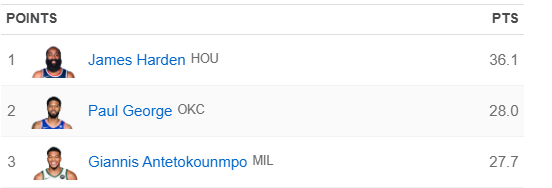

In [ ]:
df[(df["Name"] == "James Harden") | (df["Name"] == "Giannis Antetokounmpo" ) | (df["Name"] == "Paul George")] [["Name","PTS/G"]].sort_values(by="PTS/G", ascending=False)

,Name,PTS/G
140,James Harden,36.1
75,Paul George,28.0
45,Giannis Antetokounmpo,27.7


#### 4. Relevance:
Assess whether the data is appropriate and applicable for the intended analysis. Data that is not relevant can skew results and lead to incorrect conclusions.

**Key considerations for relevance include:**

> 1. Sample Appropriateness: Confirm that your data sample aligns with your analysis objectives. For instance, utilizing data from the Northern region will not yield accurate insights for the Western region of the Kingdom.
>
> 2. Variable Selection: Any column will not be relevant for our analysis, we can get rid of these using the drop() method. We will set the “axis” argument to 1 since we’re dealing with columns, and set the “inplace” argument to True to make the change permanent.


------
From an NBA Analyst POV every feature of info that could be ganied about a  player it's super benefical, because of that we won't drop any column or (feature)

In [ ]:
print("Remaining columns:")
print(df.columns)

Remaining columns:
Index(['Rk', 'Name', 'Age', 'G', 'GS', 'MP', 'FG', 'FGA', 'FG%', '3P', '3PA',
       '3P%', '2P', '2PA', '2P%', 'eFG%', 'FT', 'FTA', 'FT%', 'ORB', 'DRB',
       'TRB', 'AST', 'STL', 'BLK', 'TOV', 'PF', 'PTS/G', 'TEAM'],
      dtype='object')


##### Dropping Columns

Some columns were removed due to too many missing values or low relevance to the analysis. This helped simplify the data and keep only useful and complete data.

In [ ]:
df.head()

,Rk,Name,Age,G,GS,MP,FG,FGA,FG%,3P,...,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS/G,TEAM
0,1,Kyrie Irving,26,67,67,33.0,9.0,18.5,0.487,2.6,...,1.1,3.9,5.0,6.9,1.5,0.5,2.6,2.5,23.8,Boston Celtics
1,2,Jayson Tatum,20,79,79,31.1,5.9,13.1,0.450,1.5,...,0.9,5.2,6.0,2.1,1.1,0.7,1.5,2.1,15.7,Boston Celtics
2,3,Al Horford,32,68,68,29.0,5.7,10.6,0.535,1.1,...,1.8,5.0,6.7,4.2,0.9,1.3,1.5,1.9,13.6,Boston Celtics
3,4,Marcus Morris,29,75,53,27.9,5.0,11.3,0.447,1.9,...,1.0,5.1,6.1,1.5,0.6,0.3,1.2,2.4,13.9,Boston Celtics
4,5,Marcus Smart,24,80,60,27.5,3.0,7.1,0.422,1.6,...,0.7,2.2,2.9,4.0,1.8,0.4,1.5,2.5,8.9,Boston Celtics


#### 5. Uniqueness:
Check for and remove duplicate records to prevent skewed analysis results.


In [ ]:
#count the duplicated rows for each columns
duplicate_counts = {}
for col in df.columns:
    duplicate_counts[col] = df.duplicated(subset=[col]).sum()

print("Duplicate row count per column:\n")
for col, count in duplicate_counts.items():
    print(f"{col}: {count}")


Duplicate row count per column:

Rk: 145
Name: 14
Age: 133
G: 94
GS: 86
MP: 65
FG: 85
FGA: 60
FG%: 46
3P: 115
3PA: 84
3P%: 54
2P: 84
2PA: 62
2P%: 42
eFG%: 46
FT: 96
FTA: 88
FT%: 36
ORB: 116
DRB: 89
TRB: 71
AST: 87
STL: 128
BLK: 126
TOV: 115
PF: 123
PTS/G: 47
TEAM: 120


##### 📌 Duplicate Values Overview

The table above shows the number of duplicate rows per column in the dataset.  
These values **do not indicate data quality issues**, but rather reflect **expected repetition** in a sports context — for instance, players often appear multiple times due to trades, lineup changes, or multiple team representations throughout the season.

✅ Most duplicates are **intentional and meaningful**, especially for performance statistics that naturally repeat.

⚠️ However, the **`Name` column contains a few inconsistencies**.
These will be handled during preprocessing to ensure accurate grouping and analysis of player-level data.
---



In [ ]:
df["Name"].value_counts()

,count
Name,
Jimmy Butler,3
Kyle Lowry,2
Wesley Matthews,2
Caris LeVert,2
Robert Covington,2
...,...
Jrue Holiday,1
Anthony Davis,1
Julius Randle,1


##### 🔍 Why?

1. 🔁 Traded to another team mid-season — this applies to most repeated players (e.g., Jimmy Butler, Tobias Harris).  
2. 🕒 Some entries originate from seasons other than 2018–2019.

### ✅ What Will Be Done?

We will **keep only the traded players** by selecting the record that matches their **youngest age** during the 2018–2019 season ✅.  
Players whose records do **not match the target season** will be excluded to maintain dataset integrity and relevance 📊🏀.


In [ ]:
# Step 1: Find the top repeated player names (most frequent, e.g. 13)
top_repeated_names = df["Name"].value_counts().nlargest(13).index.tolist()

# Step 2: Split dataset into repeated players and others
df_repeated = df[df["Name"].isin(top_repeated_names)]
df_not_repeated = df[~df["Name"].isin(top_repeated_names)]

# Step 3: For repeated players, find their minimum age
min_ages = df_repeated.groupby("Name")["Age"].min().reset_index()
min_ages.rename(columns={"Age": "Min_Age"}, inplace=True)

# Step 4: Keep only repeated players' rows where Age == Min_Age
df_repeated_min_age = df_repeated.merge(min_ages, on="Name")
df_repeated_min_age = df_repeated_min_age[df_repeated_min_age["Age"] == df_repeated_min_age["Min_Age"]]

# Step 5: Drop helper column and reset index
df_repeated_min_age.drop(columns=["Min_Age"], inplace=True)
df_repeated_min_age.reset_index(drop=True, inplace=True)
df_not_repeated.reset_index(drop=True, inplace=True)

# Step 6: Concatenate filtered repeated players with non-repeated players
df_updated = pd.concat([df_not_repeated, df_repeated_min_age], ignore_index=True)

# Step 7: Optionally overwrite original df
df = df_updated
df["Name"].value_counts()

,count
Name,
Jimmy Butler,2
Robert Covington,2
Tim Hardaway Jr.,2
Harrison Barnes,2
Trevor Ariza,2
...,...
Kyle Lowry,1
Julius Randle,1
Elfrid Payton,1


In [ ]:
print(f"New shape of the DataFrame: {df.shape}")

New shape of the DataFrame: (145, 29)


In [ ]:
# Group the players PTS/G avg
df_avg_players = df.groupby("Name")["PTS/G"].mean().reset_index()[["Name", "PTS/G"]].sort_values("PTS/G", ascending=False)
df_avg_players.head()

,Name,PTS/G
57,James Harden,36.1
109,Paul George,28.0
53,Giannis Antetokounmpo,27.7
66,Joel Embiid,27.5
89,LeBron James,27.4


#### 6. Completeness:
Ensure that no critical data is missing. This might mean checking for null values or required fields that are empty.

We will start by checking the dataset for missing or null values. For this, we can use the isna() method which returns a dataframe of boolean values indicating if a field is null or not. To group all missing values by column, we can include the sum() method.

In [ ]:
df.isnull().sum()

,0
Rk,0
Name,0
Age,0
G,0
GS,0
MP,0
FG,0
FGA,0
FG%,0
3P,0


##### Actually there is no missing values at all in 3P%.
---

The problem is the listed players didn't shoot any 3PT shoots at all so the 3PA will be zero, and obviusly the 3P made shoots will be zero as well.

The problem is the percentage will be calculated as (3P / 3 PA) * 100
divison by zero will lead to NaN

The Solution is filling the 3P% by 0.0


In [ ]:
df[df.isnull().any(axis=1)][["Name","3P", "3PA", "3P%"]]

,Name,3P,3PA,3P%
20,Jarrett Allen,0.0,0.0,NaN
70,Rudy Gobert,0.0,0.0,NaN
108,DeAndre Jordan,0.0,0.0,NaN
115,Clint Capela,0.0,0.0,NaN


In [ ]:
# go to clean them
# filling the nulls
df["3P%"] = df["3P%"].fillna(0.0)
df[df.isnull().any(axis=1)][["3P", "3PA", "3P%"]]

,3P,3PA,3P%


In [ ]:
print(f"The number of nulls thruogh all the columns: {df.isnull().sum().sum()}")

The number of nulls thruogh all the columns: 0


#### 7. Check Accuracy:

Verify that the data is correct and precise. This could involve comparing data samples with known sources or using validation rules.

**The process includes:**
1. Validating the appropriateness of data types for the dataset.
2. Identifying outliers  using established validation  rule

In [ ]:
print(df.dtypes)

Rk         int64
Name      object
Age        int64
G          int64
GS         int64
MP       float64
FG       float64
FGA      float64
FG%      float64
3P       float64
3PA      float64
3P%      float64
2P       float64
2PA      float64
2P%      float64
eFG%     float64
FT       float64
FTA      float64
FT%      float64
ORB      float64
DRB      float64
TRB      float64
AST      float64
STL      float64
BLK      float64
TOV      float64
PF       float64
PTS/G    float64
TEAM      object
dtype: object


In [ ]:
# check outliers
# detect outliers using numerical statistic
numeric_cols = df.select_dtypes(include=np.number).columns

for col in numeric_cols:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    outliers = df[(df[col] < Q1 - 1.5 * IQR) | (df[col] > Q3 + 1.5 * IQR)]
    print(f"{col}: {len(outliers)} outliers")

Rk: 0 outliers
Age: 0 outliers
G: 0 outliers
GS: 0 outliers
MP: 0 outliers
FG: 0 outliers
FGA: 1 outliers
FG%: 4 outliers
3P: 2 outliers
3PA: 2 outliers
3P%: 19 outliers
2P: 0 outliers
2PA: 0 outliers
2P%: 5 outliers
eFG%: 4 outliers
FT: 2 outliers
FTA: 2 outliers
FT%: 7 outliers
ORB: 13 outliers
DRB: 4 outliers
TRB: 5 outliers
AST: 2 outliers
STL: 2 outliers
BLK: 17 outliers
TOV: 2 outliers
PF: 1 outliers
PTS/G: 1 outliers


##### 📊 Outlier Detection Summary

The outlier detection process above was based on the **Interquartile Range (IQR)** method applied to all numerical columns.  
As shown, the number of outliers per feature is relatively low and well within expected bounds.

✔️ This is **reasonable and acceptable**, especially since the dataset is only a **subset of approximately 150 players** from the 2018–2019 NBA season.  
It includes players with different roles and playing times — from high-performing starters to role players — which naturally introduces variability.


<strong>🔴These outliers is not really outliers🔴 </strong>



📌 From **domain knowledge** and comparison with **data from other NBA seasons**, these statistical outliers often represent **genuine performance differences** rather than data errors. For example:
- High `ORB` (offensive rebounds) may reflect dominant post players  
- Elevated `3P%` or `FT%` values may belong to specialist shooters  
- Extreme `AST`, `TRB`, or `TOV` values could indicate unique player responsibilities
---



##### ⚠️ Important Consideration

We **will not remove** or modify these outliers during preprocessing, as their inclusion could be crucial depending on the **final use case** of the analysis.

This analysis might support various objectives, such as:
- 📈 Tracking **individual player progression** across multiple seasons  
- 🏀 Comparing **team-level dynamics** over different eras  
- 📊 Training machine learning models for performance prediction or clustering  

🔍 Therefore, outliers should be handled **contextually** — a user or researcher may choose to subset or transform the dataset based on their specific focus.

➡️ **Flexibility** is prioritized here: The cleaned dataset will retain outliers, and filtering strategies can be applied later as needed.

**What is an Outlier?**
Outlier is an row/observation that appears far away and diverges from an overall pattern in a sample.

**What are the types of Outliers?**
1. Univariate: These outliers can be found when we look at distribution of a single variable
2. Multivariate: are outliers in an n-dimensional space. In order to find them, you have to look at distributions in multi-dimensions. example (hight=100, weight=100) for a person

**What causes Outliers?**
Whenever we come across outliers, the ideal way to tackle them is to find out the reason of having these outliers. The method to deal with them would then depend on the reason of their occurrence.

Let’s understand various types of outliers:

1. Data Entry Errors:- Human errors such as errors caused during data collection, recording, or entry can cause outliers in data.
2. Measurement Error: It is the most common source of outliers. This is caused when the measurement instrument used turns out to be faulty.
3. Data Processing Error: Whenever we perform data mining, we extract data from multiple sources. It is possible that some manipulation or extraction errors may lead to outliers in the dataset.
4. Sampling error: For instance, we have to measure the height of athletes. By mistake, we include a few basketball players in the sample. This inclusion is likely to cause outliers in the dataset.
5. Natural Outlier: When an outlier is not artificial (due to error), it is a natural outlier. For instance: In my last assignment with one of the renowned insurance company, I noticed that the performance of top 50 financial advisors was far higher than rest of the population. Surprisingly, it was not due to any error. Hence, whenever we perform any data mining activity with advisors, we used to treat this segment separately.


**What is the impact of Outliers on a dataset?**


![image.png](https://www.analyticsvidhya.com/wp-content/uploads/2015/02/Outlier_31.png)




**How to detect Outliers?**

1. Most commonly used method to detect outliers is visualization (Univariate Graphical Analysis).

We use 3 common visualization methods:
>- Box-plot: A box plot is a method for graphically depicting groups of numerical data through their quartiles. The box extends from the Q1 to Q3 quartile values of the data, with a line at the median (Q2). The whiskers extend from the edges of the box to show the range of the data. Outlier points are those past the end of the whiskers. Box plots show robust measures of location and spread as well as providing information about symmetry and outliers.
>
>  
>![image.png](https://miro.medium.com/v2/resize:fit:698/format:webp/1*VK5iHA2AB28HSZwWwUbNYg.png)
>
>
>- Histogram
>- Scatter Plot: A scatter plot is a mathematical diagram using Cartesian coordinates to display values for two variables for a set of data. The data are displayed as a collection of points, each having the value of one variable determining the position on the horizontal axis and the value of the other variable determining the position on the vertical axis. The points that are far from the population can be termed as an outlier.
>
>  
>![image.png](https://miro.medium.com/v2/resize:fit:4800/format:webp/1*Ov6aH-8yIwNoUxtMFwgx4g.png)
>
>

2. Using statistical method (Univariate Non-Graphical analysis):
>- Any value, which is beyond the range of -1.5 x IQR to 1.5 x IQR

![image.png](https://www.whatissixsigma.net/wp-content/uploads/2015/07/Box-Plot-Diagram-to-identify-Outliers-figure-1.png)

>- Use capping methods. Any value which out of range of 5th and 95th percentile can be considered as outlier
>- Data points, three or more standard deviation away from mean are considered outlier: The Z-score is the signed number of standard deviations by which the value of an observation or data point is above the mean value of what is being observed or measured. While calculating the Z-score we re-scale and center the data and look for data points that are too far from zero. These data points which are way too far from zero will be treated as the outliers. In most of the cases, a threshold of 3 or -3 is used i.e if the Z-score value is greater than or less than 3 or -3 respectively, that data point will be identified as outliers.
> - Outlier detection is merely a special case of the examination of data for influential data points and it also depends on the business understanding


In [ ]:
# Exclude non-numeric columns like 'TEAM'
numeric_cols = df.select_dtypes(include=["float64", "int64"]).columns

# Create subplot grid: adjust rows and cols as needed
rows = (len(numeric_cols) + 3) // 4  # 4 plots per row
fig = sp.make_subplots(rows=rows, cols=4, subplot_titles=numeric_cols)

# Loop through each numeric column and add box plot
for i, col in enumerate(numeric_cols):
    r = (i // 4) + 1
    c = (i % 4) + 1
    fig.add_trace(
        go.Box(y=df[col], name=col, boxpoints="outliers", marker_color="skyblue"),
        row=r, col=c
    )

# Update layout
fig.update_layout(
    height=300 * rows,  # Dynamically adjust height
    width=1200,
    title_text="📦 Box Plots for Outlier Detection",
    showlegend=False
)

fig.show()

In [ ]:
# The records shown from the quantile method isn't really outliers, because of that nono of them will be deleted
print("New shape after removing all outliers:", df.shape)

New shape after removing all outliers: (145, 29)


## 2. Data Cleaning:

Preliminary findings from data profiling can lead to cleaning the data by:
- Handling missing values
- Correcting errors.
- Dealing with outliers.

![image.png](https://miro.medium.com/v2/resize:fit:4800/format:webp/1*ILbJXAzcB3hU4LxAMG6yLw.jpeg)

-------------------



### Handling missing values:

**Why my data has missing values?**
They may occur at two stages:
1. Data Extraction: It is possible that there are problems with extraction process. Errors at data extraction stage are typically easy to find and can be corrected easily as well.
2. Data collection: These errors occur at time of data collection and are harder to correct.

**Why do we need to handle the missing data?**
To avoid:
- Bias the conclusions.
- Leading the business to make wrong decisions.

**Which are the methods to treat missing values ?**
1. Deletion: we delete rows where any of the variable is missing. Simplicity is one of the major advantage of this method, but this method reduces the power of model because it reduces the sample size.

2. Imputation: is a method to fill in the missing values with estimated ones. This imputation is one of the most frequently used methods.

    2.1. Mean/ Mode/ Median Imputation: It consists of replacing the missing data for a given attribute by the mean or median (quantitative attribute) or mode (qualitative attribute) of all known values of that variable.
    > It can be of two types:
    > - Generalized Imputation: In this case, we calculate the mean or median for all non missing values of that variable then replace missing value with mean or median.
    > - Similar case Imputation: In this case, we calculate average for each group individually of non missing values then replace the missing value based on the group.

    2.2. Constant Value
   
    2.3. Forward Filling
   
    2.4. Backward Filling

    2.5. Prediction Model:  Prediction model is one of the sophisticated method for handling missing data. Here, we create a predictive model to estimate values that will substitute the missing data.  In this case, we divide our data set into two sets: One set with no missing values for the variable and another one with missing values. First data set become training data set of the model while second data set with missing values is test data set and variable with missing values is treated as target variable. Next, we create a model to predict target variable based on other attributes of the training data set and populate missing values of test data set.

> There are 2 drawbacks for this approach:
> - The model estimated values are usually more well-behaved than the true values
> - If there are no relationships with attributes in the data set and the attribute with missing values, then the model will not be precise for estimating missing values.

    2.6. KNN Imputation: In this method of imputation, the missing values of an attribute are imputed using the given number of attributes that are most similar to the attribute whose values are missing. The similarity of two attributes is determined using a distance function. It is also known to have certain advantage & disadvantages.

   > **Advantages:**
   > - k-nearest neighbour can predict both qualitative & quantitative attributes
   > - Creation of predictive model for each attribute with missing data is not required
   > - Attributes with multiple missing values can be easily treated
   > - Correlation structure of the data is taken into consideration

   > **Disadvantage:**
   > - KNN algorithm is very time-consuming in analyzing large database. It searches through all the dataset looking for the most similar instances.
   > - Choice of k-value is very critical. Higher value of k would include attributes which are significantly different from what we need whereas lower value of k implies missing out of significant attributes.

--------------------


In [ ]:
df.isnull().sum()

,0
Rk,0
Name,0
Age,0
G,0
GS,0
MP,0
FG,0
FGA,0
FG%,0
3P,0


### Correcting errors

-------------------

No errors at all

In [ ]:
df.tail(20)

,Rk,Name,Age,G,GS,MP,FG,FGA,FG%,3P,...,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS/G,TEAM
125,4,Caris LeVert,24,40,25,26.6,5.2,12.1,0.429,1.2,...,0.9,2.9,3.8,3.9,1.1,0.4,1.7,1.9,13.7,Brooklyn Nets
126,1,Tobias Harris,26,27,27,35.0,6.9,14.8,0.469,1.6,...,1.2,6.7,7.9,2.9,0.4,0.5,1.6,2.3,18.2,Philadelphia 76ers
127,3,Robert Covington,28,13,13,33.8,3.8,9.0,0.427,2.3,...,0.5,4.6,5.2,1.1,1.8,1.8,1.7,3.5,11.3,Philadelphia 76ers
128,5,Jimmy Butler,29,55,55,33.2,6.3,13.6,0.461,0.9,...,1.9,3.4,5.3,4.0,1.8,0.5,1.5,1.7,18.2,Philadelphia 76ers
129,3,Wesley Matthews,32,23,23,31.5,3.5,9.1,0.386,2.1,...,0.5,2.3,2.8,2.4,0.9,0.2,1.3,2.4,10.9,Indiana Pacers
130,3,Otto Porter Jr.,25,15,15,32.8,6.5,13.4,0.483,2.6,...,0.9,4.6,5.5,2.7,1.2,0.6,1.7,1.9,17.5,Chicago Bulls
131,3,Trevor Ariza,33,43,43,34.1,4.8,11.8,0.409,2.2,...,0.8,4.5,5.3,3.8,1.2,0.3,1.6,2.0,14.1,Washington Wizards
132,4,Otto Porter Jr.,25,41,28,29.0,4.9,10.8,0.457,1.6,...,1.0,4.7,5.6,2.0,1.6,0.5,1.0,1.9,12.6,Washington Wizards
133,1,Aaron Gordon,23,78,78,33.8,6.0,13.4,0.449,1.6,...,1.7,5.7,7.4,3.7,0.7,0.7,2.1,2.2,16.0,Orlando Magic
134,1,Donovan Mitchell,22,77,77,33.7,8.6,19.9,0.432,2.4,...,0.8,3.3,4.1,4.2,1.4,0.4,2.8,2.7,23.8,Utah Jazz


### Dealing with outliers:

**How to remove Outliers?**
Most of the ways to deal with outliers are similar to the methods of missing values like deleting rows, transforming them, binning them, treat them as a separate group, imputing values and other statistical methods. Here, we will discuss the common techniques used to deal with outliers:

1. Deleting rows: We delete outlier values if it is due to data entry error, data processing error or outlier rows are very small in numbers. We can also use trimming at both ends to remove outliers.

2. Imputing: Like imputation of missing values, we can also impute outliers. We can use mean, median, mode imputation methods. Before imputing values, we should analyse if it is natural outlier or artificial. If it is artificial, we can go with imputing values. We can also use statistical model to predict values of outlier rows and after that we can impute it with predicted values.

3. Treat separately: If there are significant number of outliers, we should treat them separately in the statistical model. One of the approach is to treat both groups as two different groups and build individual model for both groups and then combine the output.


## 3. Univariate Analysis:

This involves examining single variables to understand their characteristics (distribution, central tendency, dispersion, and shape).

We calculate **numerical values** about the data that tells us about the distribution of the data. We also **draw graphs** showing visually how the data is distributed. **To answer the following questions about Features/characteristics of Data:**
- Where is the center of the data? (location)
- How much does the data vary? (scale)
- What is the shape of the data? (shape)

**The benefits of this analysis:**
Statistics summary gives a high-level idea to identify whether the data has any outliers, data entry error, distribution of data such as the data is normally distributed or left/right skewed

**In this step, we will explore variables one by one using following approaches:**

### 1. Univariate Graphical Analysis:
Method to perform uni-variate analysis will depend on whether the variable type is categorical or numerical.

In [ ]:
# Calculate mean
mean_pts = df_avg_players["PTS/G"].mean()

# Create the histogram
fig = px.histogram(df, x="PTS/G", nbins=30, title="Distribution of Points per Game (PTS/G)",
                   color_discrete_sequence=["skyblue"])

# Add a vertical line for the mean
fig.add_vline(x=mean_pts, line_width=3, line_dash="dash", line_color="red")

# Add annotation for the mean
fig.add_annotation(
    x=mean_pts,
    y=0,
    text=f"Mean: {mean_pts:.2f}",
    showarrow=True,
    arrowhead=1,
    ax=40,
    ay=-40,
    font=dict(color="red")
)

# Update layout
fig.update_layout(
    xaxis_title="Points Per Game (PTS/G)",
    yaxis_title="Count",
    template="plotly_white",
    bargap=0.1
)

fig.show()

In [ ]:
fig = px.box(df, x="TEAM", y="PTS/G", points="all", title="Points per Game Distribution by Team",
             labels={"PTS/G": "Points per Game", "team": "Team"})
fig.update_layout(xaxis_tickangle=-45)
fig.show()

#### I. Categorical Variables:

we’ll use frequency table to understand distribution of each category
- Bar Chart (Ordinal) - Orderd
- Pie Chart (Nominal) - non Orderd

In [ ]:
# pie chart

# Define categories
def categorize_pts(g):
    if g >= 30:
        return "30+ PPG"
    elif g >= 20:
        return "20–29.9 PPG"
    else:
        return "< 20 PPG"

# Apply categorization
df_pie_chart = df.copy()
df_pie_chart["Scoring Group"] = df_pie_chart["PTS/G"].apply(categorize_pts)

# Count players in each group
group_counts = df_pie_chart["Scoring Group"].value_counts().reset_index()
group_counts.columns = ["Scoring Group", "Count"]

# Create pie chart
fig = px.pie(
    group_counts,
    names="Scoring Group",
    values="Count",
    title="📊 Player Scoring Distribution by PTS/G",
    color="Scoring Group",
    color_discrete_map={
        "30+ PPG": "red",
        "20–29.9 PPG": "orange",
        "< 20 PPG": "green"
    },
    hole=0.4  # Optional: donut chart style
)

fig.update_traces(textinfo="label+percent", pull=[0.1, 0, 0])  # Emphasize 30+ group

fig.update_layout(
    showlegend=True,
    template="plotly_white"
)

fig.show()

In [ ]:
# bar chaart

highest_fg = df.groupby("Name")["FG%"].mean().sort_values()[-10:]

fig = px.bar(
    highest_fg,
    x=highest_fg.index,
    y=highest_fg.values,
    title="📍Top 10 Highest Feild Gola percentages"
)
fig.show()


#### II. Numerical Variables:

we need to understand the central tendency and spread of the variable (Descriptive Analysis) using:
   - Box plot
   - Histogram

In [ ]:
# Calculate descriptive stats
mean_g = df["G"].mean()
median_g = df["G"].median()

# Create the box plot
fig = px.box(df, y="G", points="all", title="Box Plot of Games Played (G)",
             color_discrete_sequence=["seagreen"])

# Add horizontal line for the mean
fig.add_hline(y=mean_g, line_width=2, line_dash="dash", line_color="red")
fig.add_annotation(
    x=0,
    y=mean_g,
    text=f"Mean: {mean_g:.2f}",
    showarrow=True,
    arrowhead=1,
    ax=80,
    ay=20,
    font=dict(color="red")
)

# Add horizontal line for the median
fig.add_hline(y=median_g, line_width=2, line_dash="dot", line_color="blue")
fig.add_annotation(
    x=0,
    y=median_g,
    text=f"Median: {median_g:.2f}",
    showarrow=True,
    arrowhead=1,
    ax=80,
    ay=-30,
    font=dict(color="blue")
)

# Update layout
fig.update_layout(
    yaxis_title="Games Played (G)",
    template="plotly_white",
    showlegend=False
)

fig.show()

In [ ]:
# Calculate the mean of MP
mean_mp = df["MP"].mean()

# Create the histogram
fig = px.histogram(df, x="MP", nbins=20, title="Distribution of Minutes Played (MP)",
                   color_discrete_sequence=["mediumpurple"])

# Add a vertical line for the mean
fig.add_vline(x=mean_mp, line_width=3, line_dash="dash", line_color="red")

# Add annotation for the mean
fig.add_annotation(
    x=mean_mp,
    y=0,
    text=f"Mean: {mean_mp:.2f}",
    showarrow=True,
    arrowhead=1,
    ax=40,
    ay=-40,
    font=dict(color="red")
)

# Update layout
fig.update_layout(
    xaxis_title="Minutes Played (MP)",
    yaxis_title="Count",
    template="plotly_white",
    bargap=0.1
)

fig.show()


In [ ]:
# Calculate stats
mean_pts = df["PTS/G"].mean()
median_pts = df["PTS/G"].median()

# Create the box plot
fig = px.box(df, y="PTS/G", points="all", title="Box Plot of Points per Game (PTS/G)",
             color_discrete_sequence=["dodgerblue"])

# Add a horizontal line for the mean
fig.add_hline(y=mean_pts, line_width=2, line_dash="dash", line_color="red")
fig.add_annotation(
    x=0,
    y=mean_pts,
    text=f"Mean: {mean_pts:.2f}",
    showarrow=True,
    arrowhead=1,
    ax=80,
    ay=20,
    font=dict(color="red")
)

# Add a horizontal line for the median
fig.add_hline(y=median_pts, line_width=2, line_dash="dot", line_color="green")
fig.add_annotation(
    x=0,
    y=median_pts,
    text=f"Median: {median_pts:.2f}",
    showarrow=True,
    arrowhead=1,
    ax=80,
    ay=-30,
    font=dict(color="green")
)

# Update layout
fig.update_layout(
    yaxis_title="Points per Game (PTS/G)",
    template="plotly_white",
    showlegend=False
)

fig.show()

### 2. Univariate Non-Graphical analysis:

- Where is the center of the data? (location) --> **Measures of central tendency**
- How much does the data vary? (scale) --> **Measure of variability**
- What is the shape of the data? (shape) --> **Measures of variation combined with an average (measure of center) gives a good picture of the distribution of the data.**

In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Rk,145.0,3.034483,1.421139,1.000,2.000,3.000,4.000,5.000
Age,145.0,26.482759,3.541624,19.000,24.000,26.000,29.000,34.000
G,145.0,56.910345,24.621839,4.000,42.000,67.000,78.000,82.000
GS,145.0,51.786207,26.085113,0.000,28.000,56.000,77.000,82.000
MP,145.0,31.146207,2.901293,24.400,28.600,31.400,33.700,36.900
FG,145.0,5.915862,1.884317,2.500,4.400,5.800,7.100,10.800
FGA,145.0,12.715172,3.775181,6.100,9.800,12.300,15.500,24.500
FG%,145.0,0.464979,0.058455,0.367,0.423,0.452,0.496,0.669
3P,145.0,1.701379,0.929082,0.000,1.100,1.800,2.300,5.100
3PA,145.0,4.620000,2.331237,0.000,3.200,4.800,6.000,13.200


In [ ]:
# describe(include=’all’) provides a statistics summary of all data, include object, category etc
df.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Rk,145.0,NaN,NaN,NaN,3.034483,1.421139,1.0,2.0,3.0,4.0,5.0
Name,145,136,Jimmy Butler,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Age,145.0,NaN,NaN,NaN,26.482759,3.541624,19.0,24.0,26.0,29.0,34.0
G,145.0,NaN,NaN,NaN,56.910345,24.621839,4.0,42.0,67.0,78.0,82.0
GS,145.0,NaN,NaN,NaN,51.786207,26.085113,0.0,28.0,56.0,77.0,82.0
MP,145.0,NaN,NaN,NaN,31.146207,2.901293,24.4,28.6,31.4,33.7,36.9
FG,145.0,NaN,NaN,NaN,5.915862,1.884317,2.5,4.4,5.8,7.1,10.8
FGA,145.0,NaN,NaN,NaN,12.715172,3.775181,6.1,9.8,12.3,15.5,24.5
FG%,145.0,NaN,NaN,NaN,0.464979,0.058455,0.367,0.423,0.452,0.496,0.669
3P,145.0,NaN,NaN,NaN,1.701379,0.929082,0.0,1.1,1.8,2.3,5.1


In [ ]:
print(f"The mean of Points per Game ({df['PTS/G'].mean()}) , The Standatd Deviation of Points per Game ({df['PTS/G'].std()})")

The mean of Points per Game (16.26896551724138) , The Standatd Deviation of Points per Game (5.37250610414548)


In [ ]:
print(f"Q1 of Points per Game: {np.quantile(df['PTS/G'],0.25)}")

Q1 of Points per Game: 12.1


## 4. Bivariate/Multivariate Analysis:

Here, you look at the relationships between two or more variables. This can involve looking for correlations, patterns, and trends that suggest a relationship or an association.

We can perform bi-variate analysis for any combination of categorical and numerical variables. The combination can be:
| bi-variate variables   | Plot type |
| ------------- | ------------- |
| Categorical & Categorical| Stacked Bar Chart |
| Categorical & numerical  | scatter plot, histogram, box plot|
| numerical  & numerical  | Scatter plot, line chart|


Multivariate Analysis:
- Heat map
- Bar Chart
- Scatter Chart
- Line Chart

We could also use a correlation matrix to get more specific information about the relationship between these two variables.

In [ ]:
# above is example of negative correlation

## Heatmap

In [ ]:
# Select only numerical columns
numeric_df = df.select_dtypes(include="number")

# Compute correlation matrix
corr_matrix = numeric_df.corr()

# Create heatmap
fig = px.imshow(
    corr_matrix,
    text_auto=".2f",
    title="📊 Correlation Heatmap of Numerical Features",
    color_continuous_scale="RdBu",  # You can also try: "RdBu_r", "plasma", etc.
    aspect="auto"
)

# Update layout for clarity
fig.update_layout(
    template="plotly_white",
    xaxis_title="Features",
    yaxis_title="Features",
    title_x=0.5,
    height=800,
    width=1500
)

fig.show()

## Bar Chart

In [ ]:
# Aggregate personal fouls by team
pf_by_team = df.groupby("TEAM", as_index=False)["PF"].mean().sort_values(by="PF", ascending=True)

# Create bar chart
fig = px.bar(pf_by_team, x="TEAM", y="PF",
             title="The Average of Personal Fouls (PF) by Team",
             color="PF",
             color_continuous_scale="RdBu_r",
             labels={"PF": "The Average of Personal Fouls", "team": "Team"})

# Update layout
fig.update_layout(
    xaxis_title="Team",
    yaxis_title="Total Personal Fouls",
    template="plotly_white",
    xaxis_tickangle=-45
)

fig.show()

## Scatterplot

In [ ]:
fig = px.scatter(
    df,
    x="Rk",
    y="PTS/G",
    title="Relationship Between Rank of a Player and Points per Game",
    labels={"G": "Games Played", "PTS/G": "Points per Game"},
    color_discrete_sequence=["royalblue"],
    trendline="ols"  # Adds a linear regression line
)

# Update layout
fig.update_layout(
    template="plotly_white",
    xaxis_title="Games Played (G)",
    yaxis_title="Points per Game (PTS/G)",
    title_x=0.5
)

fig.show()

## Line Chart

In [ ]:
# Group by TEAM and compute average blocks
team_avg_blk = df.groupby("TEAM", as_index=False)["BLK"].mean().sort_values("BLK", ascending=True)

# Create line chart
fig = px.line(
    team_avg_blk,
    x="TEAM",
    y="BLK",
    title="Average Blocks per Team",
    markers=True,
    labels={"TEAM": "Team", "BLK": "Average Blocks"},
    line_shape="linear",
    color_discrete_sequence=["darkslateblue"]
)

# Update layout
fig.update_layout(
    template="plotly_white",
    xaxis_tickangle=-45,
    title_x=0.5
)

fig.show()